# Задание 2

![image.png](attachment:image.png)

Многоклассовая классификация
1) Подготовить анализ и обработку датасета
2) Необходимо получить модель классификации (из упоминаемых в лекции), дающую одинаково высокое качество на разных классах датасета
3) Качество модели продемонстрировать с помощью посчитанных метрик
4) Выложить на github

Докачка

In [33]:
! pip install wordcloud


Импорты

In [34]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
import re
from nltk.probability import FreqDist
import pymorphy2
import pymorphy2_dicts_ru
from pymystem3 import Mystem
import seaborn as sns
from sentence_transformers import SentenceTransformer
import sklearn
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
from keras.utils import pad_sequences 
import numpy as np
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
import pandas as pd
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM, GRU
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import string
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn.model_selection import GridSearchCV

# Часть 1
Прочитаем датасет и попробуем его поанализировать

In [35]:
df = pd.read_excel('dataset.xlsx')
df.head()

,oid,text,category
0,749208109,СПОЧНО СООБЩЕСТВО ПРОДАЕТСЯ ЗА 1300Р ЗА ПОКУПК...,esport
1,749208109,Пусть это побудет здесь БорьбаВпрямомЭфире How...,esport
2,749208109,Раздача пиздюлей от Мунсунга. HowToFtokenoid Б...,esport
3,749208109,Не знаю как вам но мне стилистика нравится пус...,esport
4,749208109,Скриншоты из новой главы. Тэхунчика показали и...,esport


Удалим всякую гадость(стопслова, слова на английском языке, служебные части речи, цифры и знаки препинания)

In [36]:
def df_punctuation_clean(x):
    print(x)
    return [i for i in x if i not in string.punctuation + '\n\xa0«»\t—…'  ]

In [37]:
def dataframe_cleaning_from_bullshit(dataset):
    dataset['text'] = dataset['text'].apply(lambda x: x.lower()).apply(lambda x: re.sub(r'[^а-яА-Я\s]', '', x))
    dataset['text'] = dataset['text'].str.replace('http.*.com', '',regex = True) 
    dataset['text'] = dataset['text'].apply(lambda x: ''.join(df_punctuation_clean(x)))
    dataset.drop(columns=['oid'], inplace=True)
    dataset.drop_duplicates(inplace=True)
    dataset['text'] = dataset['text'].apply(lambda x: ''.join([i for i in x if i not in string.digits ]))
    return dataset



In [38]:
df

,oid,text,category
0,749208109,СПОЧНО СООБЩЕСТВО ПРОДАЕТСЯ ЗА 1300Р ЗА ПОКУПК...,esport
1,749208109,Пусть это побудет здесь БорьбаВпрямомЭфире How...,esport
2,749208109,Раздача пиздюлей от Мунсунга. HowToFtokenoid Б...,esport
3,749208109,Не знаю как вам но мне стилистика нравится пус...,esport
4,749208109,Скриншоты из новой главы. Тэхунчика показали и...,esport
...,...,...,...
53193,910636962,8 битная буря снова накрыла пикселями автомоби...,autosport
53194,669736851,Ира Сидоркова объясняет как сказалась на ее ма...,autosport
53195,558919241,24 я ракетка мира хорват Марин Чилич обыграл и...,tennis
53196,776944963,Стал известен календарь мужской сборной России...,volleyball


In [39]:
df = dataframe_cleaning_from_bullshit(df)

спочно сообщество продается за р за покупкой пишите в лс  все гарантии с меня 
пусть это побудет здесь борьбавпрямомэфире 
раздача пиздюлей от мунсунга  борьбавпрямомэфире
не знаю как вам но мне стилистика нравится пускай она и странная  борьбавпрямомэфире
скриншоты из новой главы тэхунчика показали и хобина 
зато они все вместе   борьбавпрямомэфире
мне кажется что мы теряем мальчика с вросшим ногтем  
недельный топ донатеров открыт минимальный донат  рубль призы самый большой донат за неделю получит  стикерпака так же рандомный донат получит  стикерпак учитываются донаты только за эту неделю  конец  августа в   по мск 
естественное восстановление после тяжелой тренировки занимает  часа с криокамерой  часа быстрее в  раза из интервью крио физиотерапевта на ютуб канале   заход в криокамеру с температурой минус  с равноценен   минутам восстановления в ледяной ванне криокамера ускоряет твое восстановление на  при естественном восстановлении организму после тяжелой тренировки требуется обы

Построим облако слов, чтобы расширить список стоп слов

In [40]:
df['splitted_text'] = df['text'].apply(lambda x: x.split())

<Axes: >

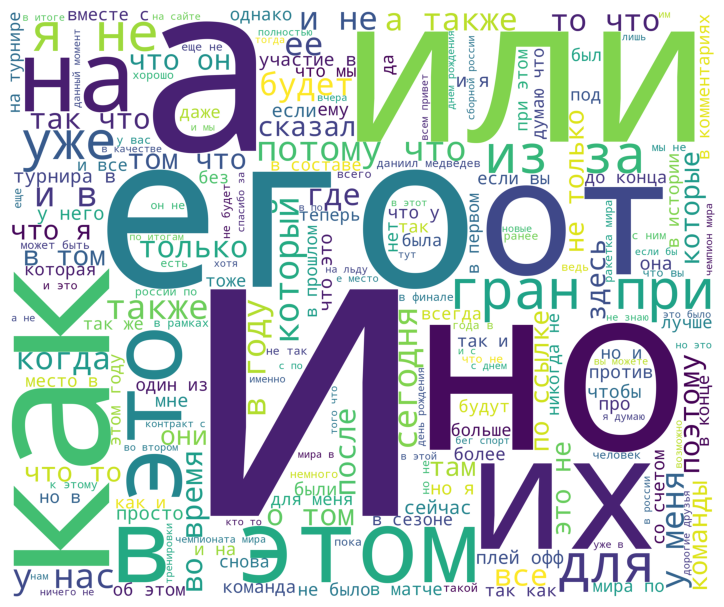

In [41]:
def str_corpus(corpus):
    str_corpus = ''
    for i in corpus:
        str_corpus += ' ' + i
    str_corpus = str_corpus.strip()
    return str_corpus
# Получение списка всех слов в корпусе
def get_corpus(data):
    corpus = []
    for phrase in data:
        for word in phrase.split():
            corpus.append(word)
    return corpus
# Получение облака слов
def get_wordCloud(corpus):
    wordCloud = WordCloud(background_color='white',
                              width=3000,
                              height=2500,
                              max_words=200,
                              random_state=42
                         ).generate(str_corpus(corpus))
    return wordCloud

corpus = get_corpus(df['text'].values)
procWordCloud = get_wordCloud(corpus)

fig = plt.figure(figsize=(20, 8))
plt.subplot(1, 2, 1)
plt.imshow(procWordCloud)
plt.axis('off')
plt.subplot(1, 2, 1)


Оххх как много у нас всякой служебной гадости, надо чистить, а заодно и токенизируем

In [42]:
def pos(word, morph=pymorphy2.MorphAnalyzer()):
    return morph.parse(word)[0].tag.POS

def stop_words_cleaning(dataset):
    morph = pymorphy2.MorphAnalyzer(lang='ru')
    functors_pos = {'INTJ', 'PRCL', 'CONJ', 'PREP'}
    nltk.download("stopwords")
    stop_words = stopwords.words("russian")
    dataset['tokenized_text'] = dataset['text'].apply(lambda x: word_tokenize(x))
    dataset['tokenized_text'] = dataset['tokenized_text'].apply(lambda x:[word for word in x if word not in stop_words and len(word) >1 and not re.search('[a-zA-Z]', word)])
    dataset.dropna(inplace=True)
    print(dataset['tokenized_text'])
    dataset['tokenized_text'] = dataset['tokenized_text'].apply(lambda x: [i for i in x if pos(i, morph) not in functors_pos])
    return dataset


In [43]:
df =  stop_words_cleaning(df)
df

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/ivzarru/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


0        [спочно, сообщество, продается, покупкой, пиши...
1                [пусть, это, побудет, борьбавпрямомэфире]
2        [раздача, пиздюлей, мунсунга, борьбавпрямомэфире]
3        [знаю, стилистика, нравится, пускай, странная,...
4        [скриншоты, новой, главы, тэхунчика, показали,...
                               ...                        
53193    [битная, буря, снова, накрыла, пикселями, авто...
53194    [ира, сидоркова, объясняет, сказалась, машине,...
53195    [ракетка, мира, хорват, марин, чилич, обыграл,...
53196    [стал, известен, календарь, мужской, сборной, ...
53197    [первенство, вхл, первый, этап, динамо, алтай,...
Name: tokenized_text, Length: 47952, dtype: object


,text,category,splitted_text,tokenized_text
0,спочно сообщество продается за р за покупкой п...,esport,"[спочно, сообщество, продается, за, р, за, пок...","[спочно, сообщество, продается, покупкой, пиши..."
1,пусть это побудет здесь борьбавпрямомэфире,esport,"[пусть, это, побудет, здесь, борьбавпрямомэфире]","[побудет, борьбавпрямомэфире]"
2,раздача пиздюлей от мунсунга борьбавпрямомэфире,esport,"[раздача, пиздюлей, от, мунсунга, борьбавпрямо...","[раздача, пиздюлей, мунсунга, борьбавпрямомэфире]"
3,не знаю как вам но мне стилистика нравится пус...,esport,"[не, знаю, как, вам, но, мне, стилистика, нрав...","[знаю, стилистика, нравится, странная, борьбав..."
4,скриншоты из новой главы тэхунчика показали и ...,esport,"[скриншоты, из, новой, главы, тэхунчика, показ...","[скриншоты, новой, главы, тэхунчика, показали,..."
...,...,...,...,...
53193,битная буря снова накрыла пикселями автомобил...,autosport,"[битная, буря, снова, накрыла, пикселями, авто...","[битная, буря, снова, накрыла, пикселями, авто..."
53194,ира сидоркова объясняет как сказалась на ее ма...,autosport,"[ира, сидоркова, объясняет, как, сказалась, на...","[ира, сидоркова, объясняет, сказалась, машине,..."
53195,я ракетка мира хорват марин чилич обыграл исп...,tennis,"[я, ракетка, мира, хорват, марин, чилич, обыгр...","[ракетка, мира, хорват, марин, чилич, обыграл,..."
53196,стал известен календарь мужской сборной россии...,volleyball,"[стал, известен, календарь, мужской, сборной, ...","[стал, известен, календарь, мужской, сборной, ..."


Посмотрим на график еще раз

<Axes: >

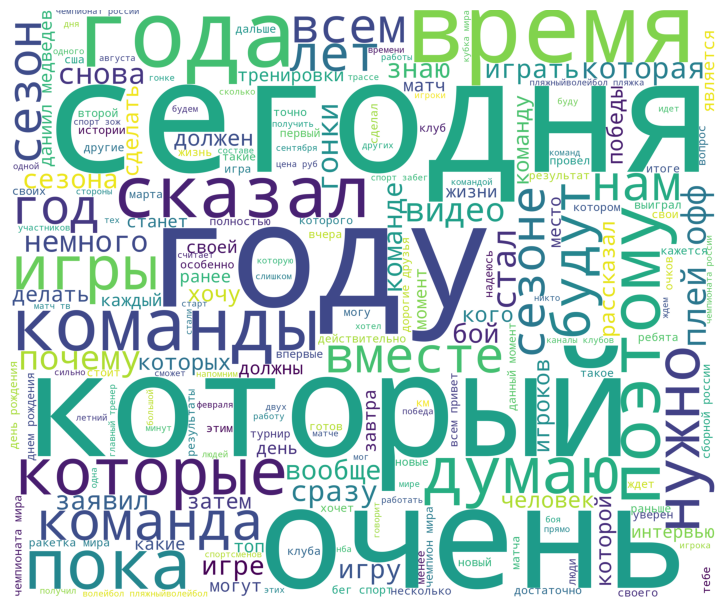

In [44]:
corpus = get_corpus(df['tokenized_text'].apply(lambda x: ' '.join(x)).values)
procWordCloud = get_wordCloud(corpus)

fig = plt.figure(figsize=(20, 8))
plt.subplot(1, 2, 1)
plt.imshow(procWordCloud)
plt.axis('off')
plt.subplot(1, 2, 1)

Еще можно исправить орфографические ошибки, но вычислительных мощностей машинки не хватает, чтобы применить это ко всему

In [45]:
#from spellchecker import SpellChecker
#biba = 0
#spell = SpellChecker(language='ru')

#def correction(text):
   # global biba
  #  biba += 1
 #   print(biba, text)
#    return [spell.correction(word) for word in text]

Лемматизируем

In [46]:
def lemmatization(df):
    mystem = Mystem() 
    df['tokenized_text'] = df['tokenized_text'].apply(lambda x: mystem.lemmatize(' '.join(x)))
    df['tokenized_text'] = df['tokenized_text'].apply(lambda x: ''.join(x).split())
    return df
df = lemmatization(df)
df

,text,category,splitted_text,tokenized_text
0,спочно сообщество продается за р за покупкой п...,esport,"[спочно, сообщество, продается, за, р, за, пок...","[спочный, сообщество, продаваться, покупка, пи..."
1,пусть это побудет здесь борьбавпрямомэфире,esport,"[пусть, это, побудет, здесь, борьбавпрямомэфире]","[побыть, борьбавпрямомэфир]"
2,раздача пиздюлей от мунсунга борьбавпрямомэфире,esport,"[раздача, пиздюлей, от, мунсунга, борьбавпрямо...","[раздача, пиздюли, мунсунг, борьбавпрямомэфир]"
3,не знаю как вам но мне стилистика нравится пус...,esport,"[не, знаю, как, вам, но, мне, стилистика, нрав...","[знать, стилистика, нравиться, странный, борьб..."
4,скриншоты из новой главы тэхунчика показали и ...,esport,"[скриншоты, из, новой, главы, тэхунчика, показ...","[скриншот, новый, глава, тэхунчик, показывать,..."
...,...,...,...,...
53193,битная буря снова накрыла пикселями автомобил...,autosport,"[битная, буря, снова, накрыла, пикселями, авто...","[битный, буря, снова, накрывать, пиксел, автом..."
53194,ира сидоркова объясняет как сказалась на ее ма...,autosport,"[ира, сидоркова, объясняет, как, сказалась, на...","[ира, сидорков, объяснять, сказываться, машина..."
53195,я ракетка мира хорват марин чилич обыграл исп...,tennis,"[я, ракетка, мира, хорват, марин, чилич, обыгр...","[ракетка, мир, хорват, марина, чилич, обыгрыва..."
53196,стал известен календарь мужской сборной россии...,volleyball,"[стал, известен, календарь, мужской, сборной, ...","[становиться, известный, календарь, мужской, с..."


Закодируем категории

In [47]:
encoding_dict = {'esport':0, 'martial_arts':1, 'tennis':2, 'basketball':3, 'volleyball':4, 'boardgames':5, 'athletics':6, 
                 'winter_sport':7, 'football':8, 'motosport':9, 'autosport':10, 'extreme' :11,'hockey':12}
df['category'] =  df['category'].apply(lambda x: encoding_dict[x])

In [48]:
df

,text,category,splitted_text,tokenized_text
0,спочно сообщество продается за р за покупкой п...,0,"[спочно, сообщество, продается, за, р, за, пок...","[спочный, сообщество, продаваться, покупка, пи..."
1,пусть это побудет здесь борьбавпрямомэфире,0,"[пусть, это, побудет, здесь, борьбавпрямомэфире]","[побыть, борьбавпрямомэфир]"
2,раздача пиздюлей от мунсунга борьбавпрямомэфире,0,"[раздача, пиздюлей, от, мунсунга, борьбавпрямо...","[раздача, пиздюли, мунсунг, борьбавпрямомэфир]"
3,не знаю как вам но мне стилистика нравится пус...,0,"[не, знаю, как, вам, но, мне, стилистика, нрав...","[знать, стилистика, нравиться, странный, борьб..."
4,скриншоты из новой главы тэхунчика показали и ...,0,"[скриншоты, из, новой, главы, тэхунчика, показ...","[скриншот, новый, глава, тэхунчик, показывать,..."
...,...,...,...,...
53193,битная буря снова накрыла пикселями автомобил...,10,"[битная, буря, снова, накрыла, пикселями, авто...","[битный, буря, снова, накрывать, пиксел, автом..."
53194,ира сидоркова объясняет как сказалась на ее ма...,10,"[ира, сидоркова, объясняет, как, сказалась, на...","[ира, сидорков, объяснять, сказываться, машина..."
53195,я ракетка мира хорват марин чилич обыграл исп...,2,"[я, ракетка, мира, хорват, марин, чилич, обыгр...","[ракетка, мир, хорват, марина, чилич, обыгрыва..."
53196,стал известен календарь мужской сборной россии...,4,"[стал, известен, календарь, мужской, сборной, ...","[становиться, известный, календарь, мужской, с..."


Посмотрим на кол-во объектов в классе

/tmp/ipykernel_263748/2422658875.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='category', data=df, palette='viridis')


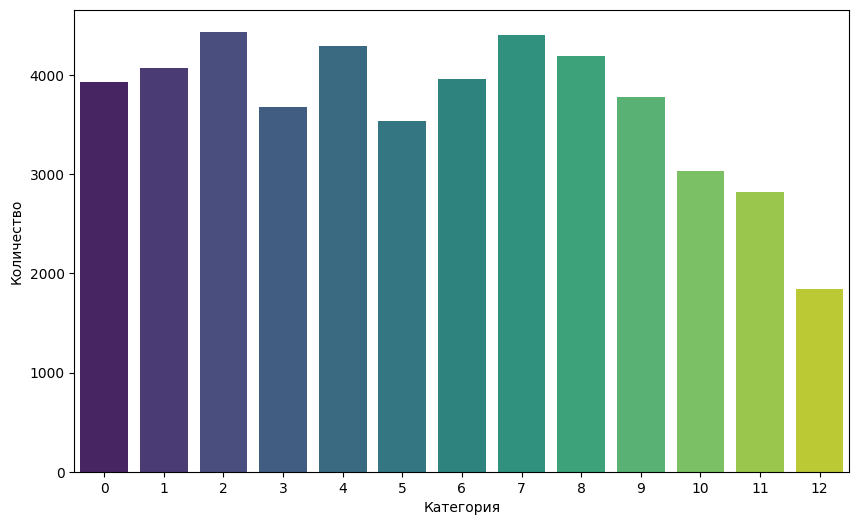

In [49]:
plt.figure(figsize=(10, 6))
sns.countplot(x='category', data=df, palette='viridis')

plt.xlabel('Категория')
plt.ylabel('Количество')
plt.xticks(np.arange(0, 13, 1)) 
plt.show()

Сбалансируем датасет, оставив в нем только по 2к записей для каждого класса

Для этого обрежем его до 2к экземпляров на каждую из категорий

In [50]:
df.groupby('category').apply(print)

                                                    text  category  \
0      спочно сообщество продается за р за покупкой п...         0   
1            пусть это побудет здесь борьбавпрямомэфире          0   
2       раздача пиздюлей от мунсунга  борьбавпрямомэфире         0   
3      не знаю как вам но мне стилистика нравится пус...         0   
4      скриншоты из новой главы тэхунчика показали и ...         0   
...                                                  ...       ...   
53112  сегодня день рождения у нашего кастера лим от ...         0   
53145  устал катать с дефолтными скинами и хочется об...         0   
53153  барса даст левандовскому двухлетний или трехле...         0   
53155  александр кокорин пропустит матч со специей из...         0   
53190   я был самым большим фанатом   а в  не терпитс...         0   

                                           splitted_text  \
0      [спочно, сообщество, продается, за, р, за, пок...   
1       [пусть, это, побудет, здесь, бо

/tmp/ipykernel_263748/2911351796.py:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df.groupby('category').apply(print)


""


In [51]:
grouped = df.groupby('category')

dfs = []

for name, group in grouped:
    #limited_group = group.head(2500)
    limited_group = group.head(2000)
    dfs.append(limited_group)

df = pd.concat(dfs, ignore_index=True)
df

,text,category,splitted_text,tokenized_text
0,спочно сообщество продается за р за покупкой п...,0,"[спочно, сообщество, продается, за, р, за, пок...","[спочный, сообщество, продаваться, покупка, пи..."
1,пусть это побудет здесь борьбавпрямомэфире,0,"[пусть, это, побудет, здесь, борьбавпрямомэфире]","[побыть, борьбавпрямомэфир]"
2,раздача пиздюлей от мунсунга борьбавпрямомэфире,0,"[раздача, пиздюлей, от, мунсунга, борьбавпрямо...","[раздача, пиздюли, мунсунг, борьбавпрямомэфир]"
3,не знаю как вам но мне стилистика нравится пус...,0,"[не, знаю, как, вам, но, мне, стилистика, нрав...","[знать, стилистика, нравиться, странный, борьб..."
4,скриншоты из новой главы тэхунчика показали и ...,0,"[скриншоты, из, новой, главы, тэхунчика, показ...","[скриншот, новый, глава, тэхунчик, показывать,..."
...,...,...,...,...
25833,вильям нюландер высказался о контрактной ситуа...,12,"[вильям, нюландер, высказался, о, контрактной,...","[вильям, нюландер, высказываться, контрактный,..."
25834,юхл регион поволжье плей офф финала нефтян...,12,"[юхл, регион, поволжье, плей, офф, финала, неф...","[юхла, регион, поволжье, плей, офф, финал, неф..."
25835,кочетков выиграл первый матч в нхл отразив бр...,12,"[кочетков, выиграл, первый, матч, в, нхл, отра...","[кочетков, выигрывать, первый, матч, нхл, отра..."
25836,летний хоккеист умер от остановки сердца в ни...,12,"[летний, хоккеист, умер, от, остановки, сердца...","[летний, хоккеист, умирать, остановка, сердце,..."


Подготовим строки для TF-IDF

In [52]:
df['for_tf_idf'] = df['tokenized_text'].apply(lambda x: ' '.join(x))
df['for_tf_idf'] = df['for_tf_idf'].values.tolist()
df['for_tf_idf'] = df['for_tf_idf'].astype(str)


Разделим датасет на тест и трейн выборку

In [53]:
X_train, X_test, y_train, y_test = train_test_split(df.drop(columns=['category', 'splitted_text', 'text', 'tokenized_text']), df['category'],stratify=df['category'], test_size=0.2, random_state=42,)


In [54]:
y_train

14414     7
7342      3
12326     6
9947      4
25732    12
         ..
24978    12
3053      1
6892      3
4809      2
18212     9
Name: category, Length: 20670, dtype: int64

In [55]:
X_train['for_tf_idf']

14414    франциск пройсс спорт жить эмоция вершина сожа...
7342     джейсон тейтум собирать защитник сбросить эла ...
12326    тренировка элиуда кипчог берлинский марафон де...
9947     поздравлять день рождение олимпийский чемпионк...
25732    олимпиада матч россия швейцария мск россия пое...
                               ...                        
24978    металлург впервые побеждать ска нева основной ...
3053     майкл биспинг карьера макгрегор находиться спа...
6892        лейкерс действительно потерять этот парень год
4809     срочно каспер рууд сниматься ао травма лодыжка...
18212    командный первенство россия кпря этап балаково...
Name: for_tf_idf, Length: 20670, dtype: object

Давайте обучим что-нибудь простое и посмотрим, что нарисуется

In [56]:
X_train.values

array([['франциск пройсс спорт жить эмоция вершина сожаление трудный момент хотеть соответствовать высокий стандарт который устанавливать сегодня очень довольный свой стрельба шаг шаг прогрессировать гонка впереди ваш прекрасный сообщение пройсс германия результат'],
       ['джейсон тейтум собирать защитник сбросить эла хорфорд дед подводить'],
       ['тренировка элиуда кипчог берлинский марафон день берлинский марафон кипчог сделать интервальный тренировка метр отдых отрезок мина грунтовый покрытие высота метр время отрезок день элиуда выполнять следующий работа метр отдых мина метр отдых сечь грунтовый покрытие высота метр итог интервальный тренировка кипчог элиудкипчог марафон'],
       ...,
       ['лейкерс действительно потерять этот парень год'],
       ['срочно каспер рууд сниматься ао травма лодыжка место сетка занимать роман сафиуллин поединок алекс молчан стартовать сразу окончание матч соуз синнер'],
       ['командный первенство россия кпря этап балаково ст труд начало мс

In [57]:
sgd_ppl_clf = Pipeline([
    ('tfidf', TfidfVectorizer()),
    ('sgd_clf', SGDClassifier(random_state=42))])
knb_ppl_clf = Pipeline([
    ('tfidf', TfidfVectorizer()),
    ('knb_clf', KNeighborsClassifier(n_neighbors=10))])
sgd_ppl_clf.fit(X_train['for_tf_idf'], y_train)
knb_ppl_clf.fit(X_train['for_tf_idf'], y_train)

Pipeline(steps=[('tfidf', TfidfVectorizer()),
                ('knb_clf', KNeighborsClassifier(n_neighbors=10))])

Посчитаем метрики

In [58]:
predicted_sgd = sgd_ppl_clf.predict(X_test['for_tf_idf'])
print(metrics.classification_report(predicted_sgd, y_test))


              precision    recall  f1-score   support

           0       0.73      0.74      0.74       396
           1       0.83      0.80      0.82       413
           2       0.97      0.93      0.95       418
           3       0.86      0.87      0.87       396
           4       0.83      0.89      0.86       371
           5       0.95      0.82      0.88       465
           6       0.80      0.83      0.82       384
           7       0.85      0.87      0.86       391
           8       0.85      0.85      0.85       403
           9       0.88      0.81      0.84       438
          10       0.81      0.86      0.84       376
          11       0.63      0.70      0.66       357
          12       0.84      0.86      0.85       360

    accuracy                           0.83      5168
   macro avg       0.83      0.83      0.83      5168
weighted avg       0.84      0.83      0.84      5168



In [59]:
predicted_sgd = knb_ppl_clf.predict(X_test['for_tf_idf'])
print(metrics.classification_report(predicted_sgd, y_test))

              precision    recall  f1-score   support

           0       0.77      0.54      0.63       569
           1       0.77      0.80      0.78       384
           2       0.94      0.88      0.91       427
           3       0.82      0.77      0.79       430
           4       0.81      0.79      0.80       415
           5       0.88      0.85      0.86       412
           6       0.79      0.75      0.77       418
           7       0.82      0.86      0.84       383
           8       0.75      0.85      0.80       351
           9       0.82      0.79      0.80       415
          10       0.72      0.85      0.78       340
          11       0.57      0.75      0.65       302
          12       0.76      0.86      0.81       322

    accuracy                           0.79      5168
   macro avg       0.79      0.80      0.79      5168
weighted avg       0.79      0.79      0.78      5168



Отлично, мы получили хорошие метрики, то, что они не сильно различаются, значит, что предобработка данных прошла успешно

TF-IDF показал себя очень хорошо, попробую сейчас поредачить другой ноутбук(прогресс этого сохраню)  с целью поисследовать другие модели

Интересно наблюдать, как просел precision для класса extreme. Возможно это потому что слова-маркеры для extreme одинаково подходят и под другие виды спорта